# data exploration

数据探索

In [1]:
!pip install --upgrade matplotlib

更新matplotlib的字体列表缓存

In [3]:
from matplotlib import font_manager
font_manager._load_fontmanager()

In [17]:
import pandas as pd


# 加载Excel文件
df = pd.read_excel('date/cleaned_data-0.xlsx')

# 描述性统计
description = df.describe()
print(description)



               个人编码  一天去两家医院的天数    就诊的月数     月就诊天数_MAX     月就诊天数_AVG  \
count  1.564900e+04     15649.0  15649.0  15649.000000  15649.000000   
mean   3.521202e+14         0.0      6.0      7.779155      5.912264   
std    7.707865e+08         0.0      0.0      3.778731      3.366966   
min    3.521200e+14         0.0      6.0      1.000000      1.000000   
25%    3.521200e+14         0.0      6.0      5.000000      3.666667   
50%    3.521200e+14         0.0      6.0      7.000000      5.166667   
75%    3.521200e+14         0.0      6.0     10.000000      7.333333   
max    3.521280e+14         0.0      6.0     17.500000     30.000000   

         月就诊医院数_MAX    月就诊医院数_AVG      就诊次数_SUM     月就诊次数_MAX     月就诊次数_AVG  \
count  15649.000000  15649.000000  15649.000000  15649.000000  15649.000000   
mean       2.110039      1.730728     36.149466      8.191674      6.129110   
std        0.942781      0.679896     19.321401      4.010131      3.214737   
min        0.000000      1.000000  

共有 82 个数值列：['个人编码', '一天去两家医院的天数', '就诊的月数', '月就诊天数_MAX', '月就诊天数_AVG', '月就诊医院数_MAX', '月就诊医院数_AVG', '就诊次数_SUM', '月就诊次数_MAX', '月就诊次数_AVG', '月统筹金额_MAX', '月统筹金额_AVG', '月药品金额_MAX', '月药品金额_AVG', '医院_就诊天数_MAX', '医院_就诊天数_AVG', '医院_统筹金_MAX', '医院_统筹金_AVG', '医院_药品_MAX', '医院_药品_AVG', '医院编码_NN', '顺序号_NN', '交易时间DD_NN', '交易时间YYYY_NN', '交易时间YYYYMM_NN', '住院天数_SUM', '个人账户金额_SUM', '统筹支付金额_SUM', 'ALL_SUM', '可用账户报销金额_SUM', '药品费发生金额_SUM', '药品费自费金额_SUM', '药品费申报金额_SUM', '贵重药品发生金额_SUM', '中成药费发生金额_SUM', '中草药费发生金额_SUM', '检查费发生金额_SUM', '检查费自费金额_SUM', '检查费申报金额_SUM', '贵重检查费金额_SUM', '治疗费发生金额_SUM', '治疗费自费金额_SUM', '治疗费申报金额_SUM', '手术费发生金额_SUM', '手术费自费金额_SUM', '手术费申报金额_SUM', '床位费发生金额_SUM', '床位费申报金额_SUM', '医用材料发生金额_SUM', '高价材料发生金额_SUM', '医用材料费自费金额_SUM', '成分输血申报金额_SUM', '其它发生金额_SUM', '其它申报金额_SUM', '一次性医用材料申报金额_SUM', '起付线标准金额_MAX', '起付标准以上自负比例金额_SUM', '医疗救助个人按比例负担金额_SUM', '最高限额以上金额_SUM', '基本统筹基金支付金额_SUM', '公务员医疗补助基金支付金额_SUM', '城乡救助补助金额_SUM', '基本个人账户支付_SUM', '非账户支付金额_SUM', '本次审批金额_SUM', '补助审批金额_SUM', '医疗救助医院申请_SUM', '残疾军人补助_S

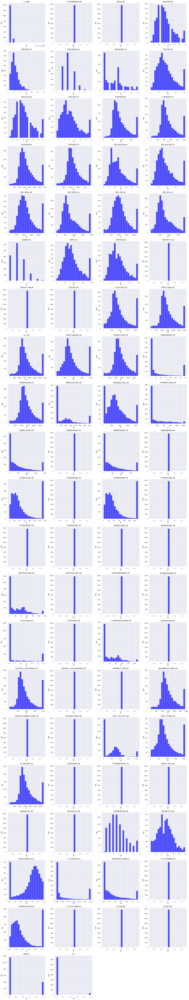

正在绘制所有数值列的散点图...


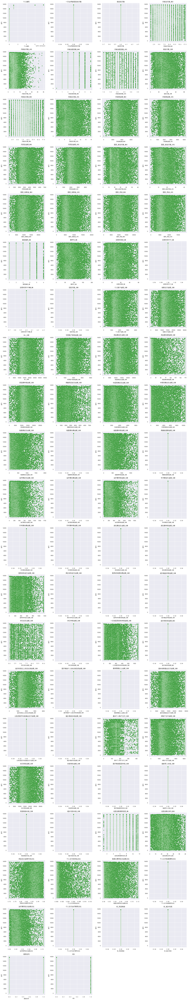

正在绘制所有数值列的箱形图...


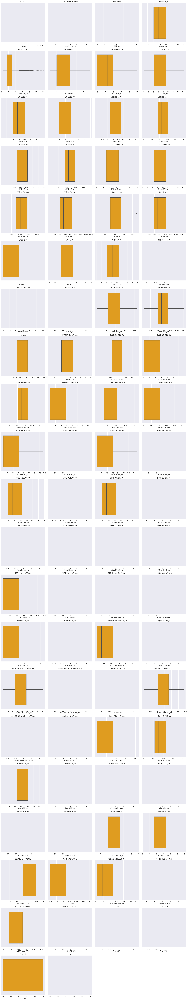

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl

# 设置中文字体，解决中文显示问题
mpl.rcParams['font.sans-serif'] = ['SimHei']  # 使用黑体
mpl.rcParams['axes.unicode_minus'] = False  # 正常显示负号

# 加载 Excel 文件
file_path = 'date/cleaned_data-0.xlsx'  # 文件路径
df = pd.read_excel(file_path)

# 筛选数值列（float 和 int 类型）
numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns

# 绘制所有数值特征的直方图
def plot_histograms(dataframe, columns):
    """
    绘制所有数值列的直方图在一个图中
    :param dataframe: 数据框
    :param columns: 数值列
    """
    num_cols = len(columns)
    cols = 4  # 每行放 4 个直方图
    rows = (num_cols + cols - 1) // cols  # 计算行数

    fig, axes = plt.subplots(rows, cols, figsize=(20, 5 * rows))
    axes = axes.flatten()

    for i, column in enumerate(columns):
        dataframe[column].hist(bins=20, ax=axes[i], alpha=0.7, color='blue')
        axes[i].set_title(column, fontsize=12)
        axes[i].set_xlabel("值", fontsize=10)
        axes[i].set_ylabel("频率", fontsize=10)

    # 删除多余的子图
    for j in range(len(columns), len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

# 绘制所有数值特征的散点图
def plot_scatterplots(dataframe, columns):
    """
    绘制所有数值列的散点图
    :param dataframe: 数据框
    :param columns: 数值列
    """
    num_cols = len(columns)
    cols = 4  # 每行放 4 个散点图
    rows = (num_cols + cols - 1) // cols  # 计算行数

    fig, axes = plt.subplots(rows, cols, figsize=(20, 5 * rows))
    axes = axes.flatten()

    for i, column in enumerate(columns):
        sns.scatterplot(data=dataframe, x=column, y=dataframe.index, ax=axes[i], color='green', alpha=0.6)
        axes[i].set_title(column, fontsize=12)
        axes[i].set_xlabel(column, fontsize=10)
        axes[i].set_ylabel("索引", fontsize=10)

    # 删除多余的子图
    for j in range(len(columns), len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

# 绘制每行 4 个的箱形图
def plot_boxplots(dataframe, columns):
    """
    绘制箱形图，每行放 4 个
    :param dataframe: 数据框
    :param columns: 数值列
    """
    num_cols = len(columns)
    cols = 4  # 每行放 4 个箱形图
    rows = (num_cols + cols - 1) // cols  # 计算行数

    fig, axes = plt.subplots(rows, cols, figsize=(20, 5 * rows))
    axes = axes.flatten()

    for i, column in enumerate(columns):
        sns.boxplot(data=dataframe, x=column, ax=axes[i], color='orange')
        axes[i].set_title(column, fontsize=12)
        axes[i].set_xlabel(column, fontsize=10)

    # 删除多余的子图
    for j in range(len(columns), len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

# 调用绘图函数
if len(numeric_cols) > 0:
    print(f"共有 {len(numeric_cols)} 个数值列：{list(numeric_cols)}")

    # 绘制所有数值列的直方图
    print("正在绘制所有数值列的直方图...")
    plot_histograms(df, numeric_cols)

    # 绘制所有数值列的散点图
    print("正在绘制所有数值列的散点图...")
    plot_scatterplots(df, numeric_cols)

    # 绘制所有数值列的箱形图
    print("正在绘制所有数值列的箱形图...")
    plot_boxplots(df, numeric_cols)
else:
    print("没有找到数值列，无法进行绘图。")